In [2]:
import pandas as pd
import numpy as np

from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
import json

from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D

from bs4 import BeautifulSoup

from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.sparse import hstack
from sklearn.metrics.pairwise import linear_kernel

# Loading CSV Files and Preprocessing

In [3]:
df = pd.read_csv("data/final/final_dataset_clean.csv")

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6767 entries, 0 to 6766
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   character_credits     6767 non-null   object
 1   character_died_in     6767 non-null   object
 2   concept_credits       6767 non-null   object
 3   cover_date            6767 non-null   object
 4   description           6669 non-null   object
 5   has_staff_review      6767 non-null   object
 6   id                    6767 non-null   int64 
 7   issue_number          6767 non-null   object
 8   location_credits      6767 non-null   object
 9   name                  6767 non-null   object
 10  object_credits        6767 non-null   object
 11  person_credits        6767 non-null   object
 12  story_arc_credits     6767 non-null   object
 13  team_credits          6767 non-null   object
 14  team_disbanded_in     6767 non-null   object
 15  volume                6767 non-null   

In [5]:
missing_values = df['description'].isnull().sum()
print(f"Missing Values: {missing_values}")

Missing Values: 98


**final_fillna** is just some final preprocessing. There cannot be null values when I go to vectorize. I found that my description lost some data between being exported and imported. 

In [6]:
def final_fillna(df):
    df['description'] = df['description'].fillna('')
    df['combined_description'] = df['combined_description'].fillna('')
    lst = ['character_credits', 'character_died_in', 'concept_credits',
           'location_credits', 'object_credits', 'person_credits', 'story_arc_credits', 
           'team_credits', 'team_disbanded_in', 'volume']
final_fillna(df)

# TfidVectorizing
I vectorized both the combined_description and each of the individual features in preparation for the model. 

In [7]:
tfidf = TfidfVectorizer(stop_words='english')
tfidf_matrix = tfidf.fit_transform(df['combined_description'])

**features within combined_description** 'character_credits', 'concept_credits', 'location_credits', 'object_credits', 'person_credits', 'story_arc_credits', 'team_credits', 'volume'

In [8]:
tfidf_des = TfidfVectorizer(stop_words='english')
tfidf_des_matrix = tfidf_des.fit_transform(df['description'])

In [9]:
tfidf_char = TfidfVectorizer(stop_words='english')
tfidf_char_matrix = tfidf_char.fit_transform(df['character_credits'])

In [10]:
tfidf_concept = TfidfVectorizer(stop_words='english')
tfidf_concept_matrix = tfidf_concept.fit_transform(df['concept_credits'])

In [11]:
tfidf_location = TfidfVectorizer(stop_words='english')
tfidf_location_matrix = tfidf_location.fit_transform(df['location_credits'])

In [12]:
tfidf_object = TfidfVectorizer(stop_words='english')
tfidf_object_matrix = tfidf_object.fit_transform(df['object_credits'])

In [13]:
tfidf_person = TfidfVectorizer(stop_words='english')
tfidf_person_matrix = tfidf_person.fit_transform(df['person_credits'])

In [14]:
tfidf_arc = TfidfVectorizer(stop_words='english')
tfidf_arc_matrix = tfidf_arc.fit_transform(df['story_arc_credits'])

In [15]:
tfidf_team = TfidfVectorizer(stop_words='english')
tfidf_team_matrix = tfidf_team.fit_transform(df['team_credits'])

In [16]:
tfidf_vol = TfidfVectorizer(stop_words='english')
tfidf_vol_matrix = tfidf_vol.fit_transform(df['volume'])

# Combining Matrixes and Weighting Them

In [17]:
tfidf_vectorizers = [tfidf_des, tfidf_char, tfidf_concept, 
                    tfidf_location, tfidf_object, tfidf_person,
                    tfidf_arc, tfidf_team, tfidf_vol]

In [18]:
all_matrices = [tfidf_des_matrix, tfidf_char_matrix, tfidf_concept_matrix, 
               tfidf_location_matrix, tfidf_object_matrix, tfidf_person_matrix,
               tfidf_arc_matrix, tfidf_team_matrix, tfidf_vol_matrix]

In [19]:
weights = [3, 2, 1,
           1, 0, 1,
           0, 1, 0]

In [20]:
# Scale each TF-IDF matrix by its corresponding weight
weighted_tfidf_matrices = [matrix * weight for matrix, weight in zip(all_matrices, weights)]

In [21]:
combined_matrix = hstack(weighted_tfidf_matrices)

# COSINE_SIM & RECOMMENDATION FUNCTION

In [22]:
cosine_sim = linear_kernel(combined_matrix, combined_matrix)

In [23]:
cosine_sim

array([[17.        ,  8.84541377,  7.36929182, ...,  0.26497636,
         0.22945786,  0.46966671],
       [ 8.84541377, 16.        ,  6.70261908, ...,  0.27953821,
         0.24292362,  0.37036255],
       [ 7.36929182,  6.70261908, 16.        , ...,  0.44460644,
         0.40874802,  0.22796438],
       ...,
       [ 0.26497636,  0.27953821,  0.44460644, ..., 16.        ,
         3.99696656,  3.58415581],
       [ 0.22945786,  0.24292362,  0.40874802, ...,  3.99696656,
        15.        ,  5.73033285],
       [ 0.46966671,  0.37036255,  0.22796438, ...,  3.58415581,
         5.73033285, 16.        ]])

In [24]:
# Assuming df['name'] contains the comic issue names
#comic_issue_names = df['name'].tolist()  # Replace with your actual column if different

In [25]:
#np.savetxt('cosine_similarity_matrix.csv', cosine_sim, delimiter=',', header=','.join(comic_issue_names), comments='')

In [26]:
def load_cosine_similarity_matrix(file_path):
    try:
        cosine_sim_df = pd.read_csv(file_path, index_col=0, encoding='latin-1')
        return cosine_sim_df.values  # Return the matrix values as a NumPy array
    except FileNotFoundError:
        print(f"Error: File '{file_path}' not found.")
        return None
    except Exception as e:
        print(f"Error: Unable to load cosine similarity matrix from '{file_path}': {e}")
        return None

# Function to get recommendations based on cosine similarity
def get_recommendations(df, title, cosine_sim):
    try:
        idx = df[df['name'] == title].index[0]
        sim_scores = list(enumerate(cosine_sim[idx]))
        sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
        sim_scores = sim_scores[0:21]  # Skip the first one as it is the title itself
        issue_indices = [i[0] for i in sim_scores]
        return df.iloc[issue_indices]
    except IndexError:
        print(f"Error: Comic issue '{title}' not found.")
        return pd.DataFrame(columns=df.columns)

In [27]:
#cosine_sim_tmp = load_cosine_similarity_matrix("cosine_similarity_matrix.csv")

In [28]:
#get_recommendations(df, "Welcome to Gotham Academy", cosine_sim_tmp)

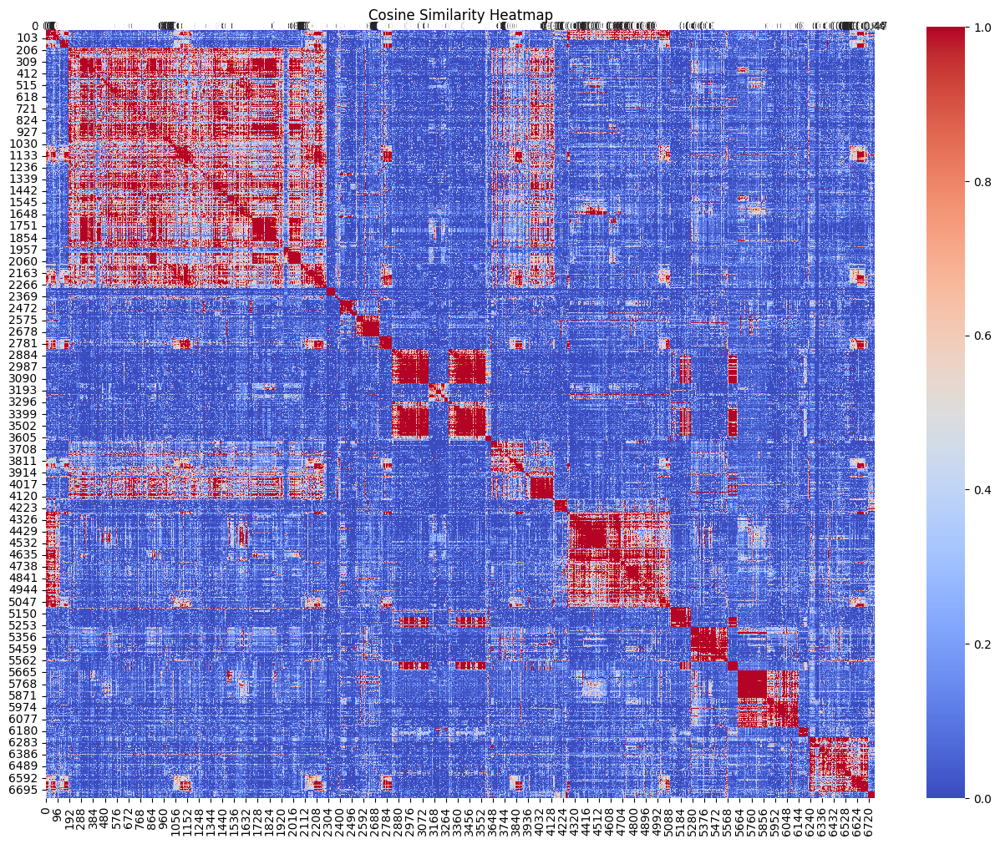

In [29]:
plt.figure(figsize=(16, 12))
sns.heatmap(cosine_sim, annot=True, cmap='coolwarm', vmin=0, vmax=1)
plt.title('Cosine Similarity Heatmap')
plt.show()

The red represents similarity while the blue represents difference. Most of my data is different from each other, but there are clusters of red similarity splattered here and there. I'm infer that these red clusters come from being in the same volume and getting concatted near each other when I created the final dataset. 
<br>
Next Steps
Cluster Analysis: You might want to perform clustering algorithms (e.g., K-means, hierarchical clustering) to formally identify these groups.
Dimensionality Reduction: Techniques like PCA or t-SNE could help visualize the data in a reduced dimensional space.
Feature Importance: Analyzing which features contribute most to these similarities could be insightful.
Would you like further analysis or assistance with another aspect of your data?

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6767 entries, 0 to 6766
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   character_credits     6767 non-null   object
 1   character_died_in     6767 non-null   object
 2   concept_credits       6767 non-null   object
 3   cover_date            6767 non-null   object
 4   description           6767 non-null   object
 5   has_staff_review      6767 non-null   object
 6   id                    6767 non-null   int64 
 7   issue_number          6767 non-null   object
 8   location_credits      6767 non-null   object
 9   name                  6767 non-null   object
 10  object_credits        6767 non-null   object
 11  person_credits        6767 non-null   object
 12  story_arc_credits     6767 non-null   object
 13  team_credits          6767 non-null   object
 14  team_disbanded_in     6767 non-null   object
 15  volume                6767 non-null   

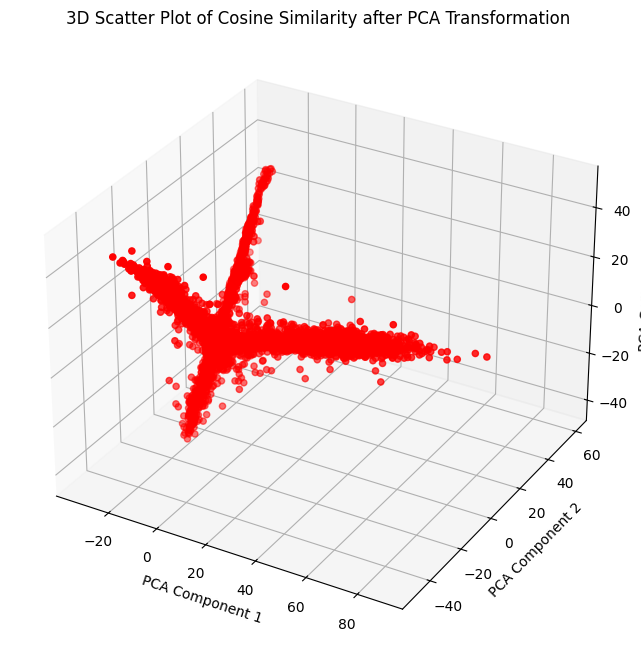

In [31]:
pca = PCA(n_components=3)
cosine_sim_pca = pca.fit_transform(cosine_sim)

# Create 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(cosine_sim_pca[:, 0], cosine_sim_pca[:, 1], cosine_sim_pca[:, 2], c='red', marker='o')
ax.set_xlabel('PCA Component 1')
ax.set_ylabel('PCA Component 2')
ax.set_zlabel('PCA Component 3')
ax.set_title('3D Scatter Plot of Cosine Similarity after PCA Transformation')
plt.show()

Practical Implications
Identifying Similar Groups:

The clusters can help you identify groups of comic books that are similar in terms of their attributes. This can be useful for tasks like recommendation systems or market segmentation.
For instance, if you're analyzing comic book sales data, these clusters might represent different genres or target audiences.
Feature Influence:

Understanding the principal components can help you determine which features are driving these similarities.
By examining the loadings (the contribution of each original feature to the principal components), you can interpret which attributes are most important for the similarity structure.
Next Steps
Cluster Analysis:

You might want to apply clustering algorithms (like K-means or hierarchical clustering) on the PCA-transformed data to formally identify clusters.
This can help you understand the distinct groups within your dataset more clearly.
Dimensionality Reduction:

If the three principal components explain most of the variance, the dimensionality reduction is successful. If not, consider looking at more components or different methods.

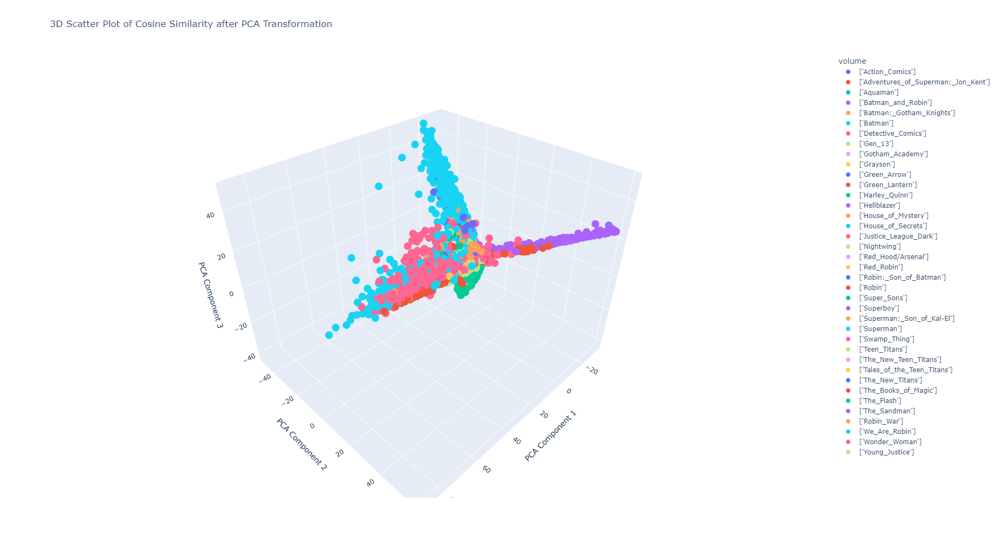

<Figure size 8000x6400 with 0 Axes>

In [32]:
import plotly.express as px
import plotly.graph_objects as go

pca = PCA(n_components=3)
cosine_sim_pca = pca.fit_transform(cosine_sim)
cos_df = pd.DataFrame(cosine_sim_pca, columns=['PCA Component 1', 'PCA Component 2', 'PCA Component 3'])
cos_df['comic_name'] = df['name']
cos_df['volume'] = df['volume']
cos_df['character_credits'] = df['character_credits']
cos_df['description'] = df['description']
fig = plt.figure(figsize=(80, 64))
fig = px.scatter_3d(cos_df, x='PCA Component 1', y='PCA Component 2', z='PCA Component 3',
                    color='volume',  # Color points based on 'volume'
                    hover_data={'comic_name': True, 'volume': True, 'character_credits':False, 'description':False},
                    title='3D Scatter Plot of Cosine Similarity after PCA Transformation')
fig.update_layout(
    hovermode='closest',  # Show hover info for closest point
    hoverlabel=dict(bgcolor="white", font_size=16, namelength=-1),
    width=int(1400), height=int(1000))
    
fig.show()

In [33]:
#fig layout, update layout

In [34]:
#width and height

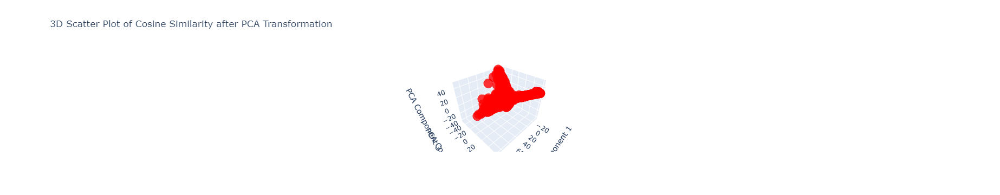

In [35]:
import numpy as np
import plotly.graph_objs as go
from sklearn.decomposition import PCA

# Perform PCA
pca = PCA(n_components=3)
cosine_sim_pca = pca.fit_transform(cosine_sim)

# Example comic issue names (replace with your actual comic names)
comic_names = df['name']

# Create 3D scatter plot using Plotly
fig = go.Figure(data=[go.Scatter3d(
    x=cosine_sim_pca[:, 0],
    y=cosine_sim_pca[:, 1],
    z=cosine_sim_pca[:, 2],
    mode='markers',
    marker=dict(
        size=10,
        color='red',  # Set color
        opacity=0.8
    ),
    text=comic_names,  # Set text (comic names) for hover
    hoverinfo='text'   # Show text on hover
)])

# Update layout
fig.update_layout(
    title='3D Scatter Plot of Cosine Similarity after PCA Transformation',
    scene=dict(
        xaxis=dict(title='PCA Component 1'),
        yaxis=dict(title='PCA Component 2'),
        zaxis=dict(title='PCA Component 3')
    )
)

# Show the interactive plot (in Jupyter Notebook or standalone HTML)
fig.show()
